# Notebook to run differential expression analysis on CMC using ´PyDESeq2´

**Created by** : **Srivalli Kolla**

**Developed on** : 20 November,2024  

**Last Modified** : 20 November,2024 

**Institute of Systems Immunology, University of Wurzburg**

Env : pydeseq2

I have choosen logFC cutoff 1.0 in this notebook

# Importing packages

In [1]:
import scanpy as sc
import scipy.sparse as sp
import pandas as pd
import anndata as ad
import numpy as np
import datetime
import requests
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
from scipy import sparse
from scipy.sparse import issparse

from pydeseq2.dds import DeseqDataSet
from pydeseq2.default_inference import DefaultInference
from pydeseq2.ds import DeseqStats
from itertools import product
from wordcloud import WordCloud

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

timestamp = datetime.datetime.now().strftime("%d_%m_%y,%H:%M")
timestamp

-----
anndata     0.10.8
scanpy      1.10.2
-----
PIL                 10.3.0
asttokens           NA
certifi             2024.07.04
cffi                1.17.1
charset_normalizer  3.4.0
colorama            0.4.6
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0.post0
debugpy             1.8.2
decorator           5.1.1
django              5.0.6
executing           2.0.1
h5py                3.11.0
idna                3.10
ipykernel           6.29.5
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
legacy_api_wrap     NA
llvmlite            0.43.0
matplotlib          3.9.1
mpl_toolkits        NA
natsort             8.4.0
numba               0.60.0
numpy               1.26.4
packaging           24.1
pandas              2.2.2
parso               0.8.4
patsy               0.5.6
pickleshare         0.7.5
platformdirs        4.2.2
prompt_toolkit      3.0.47
psutil              6.0.0
pure_eval           0.2.2
pydeseq

'20_11_24,13:21'

## Helper Functions

In [3]:
ENRICHR_ADD_LIST_URL = "https://maayanlab.cloud/Enrichr/addList"
ENRICHR_ENRICH_URL = "https://maayanlab.cloud/Enrichr/enrich"
enrichr_background_url = "https://maayanlab.cloud/Enrichr/datasetStatistics"

response = requests.get(enrichr_background_url)
databases = response.json()

In [4]:
BACKGROUND_TYPE = "Reactome_2022"

1. Create a loop to submit the gene list in batches 
2. Check the output if Gene, Pathway cols are present if yes consider, if not select col 1,5 for pathway and gene specifically


In [5]:
def pseudobulk_from_adata(adata: ad.AnnData) -> ad.AnnData:
    return ad.AnnData(
        X=sparse.csr_matrix(adata.X.toarray().sum(axis=0)),
        obs=adata.obs[filter(lambda column: len(set(adata.obs[column])) == 1, adata.obs.columns)].head(1),
        var=adata.var
    )

def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

def submit_enrichment_batches(gene_batches):

    pathway_results = {}

    for i, gene_batch in enumerate(gene_batches):
        genes_str = '\n'.join(gene_batch)
        payload = {'list': (None, genes_str), 'description': f'Pathway enrichment batch {i+1}'}

        for attempt in range(3):
            try:
                response = requests.post(ENRICHR_ADD_LIST_URL, files=payload, timeout=10)
                if response.status_code == 200:
                    user_list_id = response.json().get('userListId')
                    print(f"Batch {i+1} submitted successfully. User list ID: {user_list_id}")

                    enrich_response = requests.get(f"{ENRICHR_ENRICH_URL}?userListId={user_list_id}&backgroundType={BACKGROUND_TYPE}", timeout=10)
                    if enrich_response.status_code == 200:
                        enrichment_results = enrich_response.json()

                        if BACKGROUND_TYPE in enrichment_results:
                            batch_df = pd.DataFrame(enrichment_results[BACKGROUND_TYPE])

                            if len(batch_df) > 0:
                               
                                if 'Term' in batch_df.columns:
                                    pathway_column = 'Term'
                                    genes_column = 'Genes'
                                elif 'Pathway' in batch_df.columns:
                                    pathway_column = 'Pathway'
                                    genes_column = 'Genes'
                                elif 1 in batch_df.columns and 5 in batch_df.columns:
                                    pathway_column = 1
                                    genes_column = 5
                                else:
                                    print("Warning: Unknown pathway column structure in response.")
                                    print("Unexpected batch structure:", batch_df.head())
                                    continue

                                for _, row in batch_df.iterrows():
                                    pathway = row[pathway_column]
                                    genes_in_pathway = row[genes_column]

                                    for gene in genes_in_pathway:
                                        if gene in pathway_results:
                                            pathway_results[gene].append(pathway)
                                        else:
                                            pathway_results[gene] = [pathway]

                    break
                else:
                    print(f"Error submitting batch {i+1} (Status code: {response.status_code})")
            except requests.exceptions.RequestException as e:
                print(f"Attempt {attempt+1} failed for batch {i+1}: {e}")

    return pathway_results

# Data Import

In [6]:
adata = sc.read_h5ad('../data/dmd_annotated_cmc_concatenated_19_11_24,16:32.h5ad')
adata

AnnData object with n_obs × n_vars = 84692 × 29378
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', 'cell_state_scNym_confidence', 'cell_state', 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_counts', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions', 'leiden_scArches', 'sample', 'seed_labels', 'genotype', 'doublet_scores', 'predicted_doublets', 'percent_chrY', 'XIST-counts', 'XIST-percentage', 'gender_check_cov', 'S_score', 'G2M_score', 'phase', 'C_scANVI', 'ref'
    var: 'mt', 'ribo', 'n_cells_b

In [7]:
X_is_raw(adata)

True

# Dataprep for deseq

In [8]:
adata.obs['sample'].value_counts()

sample
A10_2    54763
B1_2     20203
B2_2      4797
A9_2      1839
A12_2     1591
A11_2     1499
Name: count, dtype: int64

In [9]:
pseudobulk = ad.concat(map(pseudobulk_from_adata, map(lambda batch: adata[adata.obs["sample"] == batch],set(adata.obs["sample"]))))
pseudobulk

AnnData object with n_obs × n_vars = 6 × 29378
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_leiden', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions', 'leiden_scArches', 'sample', 'seed_labels', 'genotype', 'ref'

In [10]:
counts_df = pd.DataFrame(pseudobulk.X.toarray().astype(int), index=pseudobulk.obs_names, columns=pseudobulk.var_names)
metadata = pseudobulk.obs

In [11]:
counts_df

,Xkr4,Gm1992,Gm19938,Gm37381,Rp1,Sox17,Gm37587,Gm37323,Mrpl15,Lypla1,...,Vmn2r122,Il11ra2-1,Ccl27a-1,Ccl21c-1,Ccl27a-2,Il11ra2-2,Ccl19-1,Ccl21a-1,Gm10931,Gm16367
ACACCAAAGAGGTATT-1-query-query,77,6,8,38,269,169,6,1,1124,1513,...,0,0,0,0,0,0,0,0,1,0
CTCAACCAGATCCAAA-1,7,0,1,3,64,6,1,0,238,166,...,0,0,0,0,0,0,0,0,0,0
TGATTCTCATACCGTA-1-query-query,0,0,0,14,394,3,1,0,435,743,...,0,0,0,0,0,0,0,0,0,0
GCTCAAATCCGCAACG-1-query-query,19,4,3,6,174,21,0,0,365,599,...,0,0,0,0,0,0,0,0,0,0
TAATTCCTCTACTCAT-1,105,16,3,9,221,278,4,0,5179,2408,...,0,0,0,0,0,0,0,0,0,0
CTGCAGGGTTCGGACC-1-query-query,10,0,5,6,36,34,0,0,228,303,...,0,0,0,0,0,0,0,0,1,0


In [12]:
metadata

,sangerID,combinedID,donor,donor_type,region,region_finest,age,gender,facility,cell_or_nuclei,...,clus20,doublet_cls,original_or_new,batch,scANVI_predictions,leiden_scArches,sample,seed_labels,genotype,ref
ACACCAAAGAGGTATT-1-query-query,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,query,NaN,NaN,B1_2,Unknown,MdxSCID,wt
CTCAACCAGATCCAAA-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,query,NaN,NaN,A9_2,Unknown,WT,human
TGATTCTCATACCGTA-1-query-query,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,query,NaN,NaN,A12_2,Unknown,Mdx,wt
GCTCAAATCCGCAACG-1-query-query,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,query,NaN,NaN,A11_2,Unknown,Mdx,wt
TAATTCCTCTACTCAT-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,query,NaN,NaN,A10_2,Unknown,WT,human
CTGCAGGGTTCGGACC-1-query-query,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,query,NaN,NaN,B2_2,Unknown,MdxSCID,wt


# DeSeq

In [13]:
inference = DefaultInference(n_cpus=8)

WT_dds = DeseqDataSet(
    counts=counts_df,
    metadata=metadata,
    design_factors='genotype',  
    refit_cooks=True,
    inference=inference, ref_level = ('genotype', 'WT')
)

In [14]:
inference = DefaultInference(n_cpus=8)

Mdx_dds = DeseqDataSet(
    counts=counts_df,
    metadata=metadata,
    design_factors='genotype',  
    refit_cooks=True,
    inference=inference, ref_level = ('genotype', 'Mdx')
)

In [15]:
inference = DefaultInference(n_cpus=8)

MdxSCID_dds = DeseqDataSet(
    counts=counts_df,
    metadata=metadata,
    design_factors='genotype',  
    refit_cooks=True,
    inference=inference, ref_level = ('genotype', 'MdxSCID')
)

In [16]:
WT_dds.deseq2()

Fitting size factors...
... done in 0.00 seconds.

Fitting dispersions...
... done in 1.85 seconds.

Fitting dispersion trend curve...
... done in 0.33 seconds.

/home/skolla/miniforge3/envs/pydeseq2/lib/python3.12/site-packages/pydeseq2/dds.py:497: UserWarning: As the residual degrees of freedom is less than 3, the distribution of log dispersions is especially asymmetric and likely to be poorly estimated by the MAD.
  self.fit_dispersion_prior()
Fitting MAP dispersions...
... done in 1.90 seconds.

Fitting LFCs...
... done in 1.77 seconds.

Calculating cook's distance...
... done in 0.01 seconds.

Replacing 0 outlier genes.



In [17]:
Mdx_dds.deseq2()

Fitting size factors...
... done in 0.00 seconds.

Fitting dispersions...
... done in 1.32 seconds.

Fitting dispersion trend curve...
... done in 0.29 seconds.

/home/skolla/miniforge3/envs/pydeseq2/lib/python3.12/site-packages/pydeseq2/dds.py:497: UserWarning: As the residual degrees of freedom is less than 3, the distribution of log dispersions is especially asymmetric and likely to be poorly estimated by the MAD.
  self.fit_dispersion_prior()
Fitting MAP dispersions...
... done in 1.39 seconds.

Fitting LFCs...
... done in 1.21 seconds.

Calculating cook's distance...
... done in 0.00 seconds.

Replacing 0 outlier genes.



In [18]:
MdxSCID_dds.deseq2()

Fitting size factors...
... done in 0.00 seconds.

Fitting dispersions...
... done in 1.24 seconds.

Fitting dispersion trend curve...
... done in 0.28 seconds.

/home/skolla/miniforge3/envs/pydeseq2/lib/python3.12/site-packages/pydeseq2/dds.py:497: UserWarning: As the residual degrees of freedom is less than 3, the distribution of log dispersions is especially asymmetric and likely to be poorly estimated by the MAD.
  self.fit_dispersion_prior()
Fitting MAP dispersions...
... done in 1.39 seconds.

Fitting LFCs...
... done in 1.43 seconds.

Calculating cook's distance...
... done in 0.01 seconds.

Replacing 0 outlier genes.



In [19]:
stat_res1 = DeseqStats(WT_dds, alpha=0.05, cooks_filter=True, independent_filter=True)
stat_res1.summary()

Running Wald tests...


Log2 fold change & Wald test p-value: genotype MdxSCID vs WT
             baseMean  log2FoldChange     lfcSE      stat    pvalue      padj
Xkr4        22.351047       -0.001808  1.142287 -0.001583  0.998737  0.999530
Gm1992       2.148276       -1.191647  2.751397 -0.433106  0.664938       NaN
Gm19938      3.760212        2.278377  1.967776  1.157844  0.246928       NaN
Gm37381     10.087941        1.719043  1.199627  1.432982  0.151863       NaN
Rp1        162.752680       -0.148749  0.609182 -0.244178  0.807093  0.999159
...               ...             ...       ...       ...       ...       ...
Il11ra2-2    0.000000             NaN       NaN       NaN       NaN       NaN
Ccl19-1      0.000000             NaN       NaN       NaN       NaN       NaN
Ccl21a-1     0.000000             NaN       NaN       NaN       NaN       NaN
Gm10931      0.493435        3.027104  5.301439  0.570997  0.568002       NaN
Gm16367      0.000000             NaN       NaN       NaN       NaN       NaN

[2

... done in 3.84 seconds.



In [20]:
stat_res2 = DeseqStats(Mdx_dds, alpha=0.05, cooks_filter=True, independent_filter=True)
stat_res2.summary()

Running Wald tests...


Log2 fold change & Wald test p-value: genotype MdxSCID vs Mdx
             baseMean  log2FoldChange     lfcSE      stat    pvalue      padj
Xkr4        22.351047        1.589581  1.167985  1.360960  0.173526  0.382863
Gm1992       2.148276       -0.455503  2.771974 -0.164324  0.869476       NaN
Gm19938      3.760212        2.335601  1.956368  1.193846  0.232538       NaN
Gm37381     10.087941        0.710396  1.142231  0.621937  0.533983  0.720998
Rp1        162.752680       -1.397657  0.602754 -2.318786  0.020407  0.096839
...               ...             ...       ...       ...       ...       ...
Il11ra2-2    0.000000             NaN       NaN       NaN       NaN       NaN
Ccl19-1      0.000000             NaN       NaN       NaN       NaN       NaN
Ccl21a-1     0.000000             NaN       NaN       NaN       NaN       NaN
Gm10931      0.493435        2.977389  5.245294  0.567630  0.570286       NaN
Gm16367      0.000000             NaN       NaN       NaN       NaN       NaN

[

... done in 1.19 seconds.



In [21]:
stat_res3 = DeseqStats(MdxSCID_dds, alpha=0.05, cooks_filter=True, independent_filter=True)
stat_res3.summary()

Running Wald tests...


Log2 fold change & Wald test p-value: genotype WT vs MdxSCID
             baseMean  log2FoldChange     lfcSE      stat    pvalue      padj
Xkr4        22.351047        0.001815  1.142230  0.001589  0.998732  0.999534
Gm1992       2.148276        1.191630  2.750975  0.433167  0.664894       NaN
Gm19938      3.760212       -2.278377  1.967535 -1.157985  0.246870       NaN
Gm37381     10.087941       -1.719062  1.199513 -1.433134  0.151820       NaN
Rp1        162.752680        0.148754  0.609230  0.244167  0.807102  0.999148
...               ...             ...       ...       ...       ...       ...
Il11ra2-2    0.000000             NaN       NaN       NaN       NaN       NaN
Ccl19-1      0.000000             NaN       NaN       NaN       NaN       NaN
Ccl21a-1     0.000000             NaN       NaN       NaN       NaN       NaN
Gm10931      0.493435       -3.027099  5.301472 -0.570992  0.568005       NaN
Gm16367      0.000000             NaN       NaN       NaN       NaN       NaN

[2

... done in 1.37 seconds.



In [22]:
stat_res1.results_df

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
Xkr4,22.351047,-0.001808,1.142287,-0.001583,0.998737,0.999530
Gm1992,2.148276,-1.191647,2.751397,-0.433106,0.664938,NaN
Gm19938,3.760212,2.278377,1.967776,1.157844,0.246928,NaN
Gm37381,10.087941,1.719043,1.199627,1.432982,0.151863,NaN
Rp1,162.752680,-0.148749,0.609182,-0.244178,0.807093,0.999159
...,...,...,...,...,...,...
Il11ra2-2,0.000000,NaN,NaN,NaN,NaN,NaN
Ccl19-1,0.000000,NaN,NaN,NaN,NaN,NaN
Ccl21a-1,0.000000,NaN,NaN,NaN,NaN,NaN
Gm10931,0.493435,3.027104,5.301439,0.570997,0.568002,NaN


In [23]:
stat_res1.results_df.to_csv(f'../differential_gene_expression/DE_results/DE_pydeseq2_cmc_logfc_1.0_Wt_vs_all_{timestamp}.tsv')
stat_res2.results_df.to_csv(f'../differential_gene_expression/DE_results/DE_pydeseq2_cmc_logfc_1.0_Mdx_vs_all_{timestamp}.tsv')
stat_res3.results_df.to_csv(f'../differential_gene_expression/DE_results/DE_pydeseq2_cmc_logfc_1.0_Mdxscid_vs_all_{timestamp}.tsv')

# Enrichment analysis with EnrichR

## Wt_vs_all

In [24]:
filtered = stat_res1.results_df[stat_res1.results_df['log2FoldChange'].abs() > 1.0]
filtered

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
Gm1992,2.148276,-1.191647,2.751397,-0.433106,0.664938,NaN
Gm19938,3.760212,2.278377,1.967776,1.157844,0.246928,NaN
Gm37381,10.087941,1.719043,1.199627,1.432982,0.151863,NaN
Gm37323,0.069963,1.356063,5.486359,0.247170,0.804777,NaN
Mrpl15,731.976396,-1.292232,0.623507,-2.072522,0.038217,0.461587
...,...,...,...,...,...,...
Gm28827,0.065341,-1.082561,5.486135,-0.197327,0.843572,NaN
Gm20837,0.065341,-1.082561,5.486135,-0.197327,0.843572,NaN
Gm21860,6.174756,-3.100775,1.747899,-1.774001,0.076063,NaN
Gm47283,804.296795,-1.312450,0.573987,-2.286551,0.022222,0.357993


In [25]:
filtered.index = filtered.index.str.upper()
filtered.index

Index(['GM1992', 'GM19938', 'GM37381', 'GM37323', 'MRPL15', 'RGS20', 'GM16041',
       'OPRK1', 'ALKAL1', 'ST18',
       ...
       'GM28612', 'GM20843', 'GM29564', 'GM28897', 'GM21317', 'GM28827',
       'GM20837', 'GM21860', 'GM47283', 'GM10931'],
      dtype='object', length=8516)

In [26]:
genes = filtered.index.tolist()  
genes

['GM1992',
 'GM19938',
 'GM37381',
 'GM37323',
 'MRPL15',
 'RGS20',
 'GM16041',
 'OPRK1',
 'ALKAL1',
 'ST18',
 'VXN',
 'SNHG6',
 'GM15818',
 'GM29283',
 'SBSPON',
 'RPL7',
 'GM7568',
 'ELOC',
 'TMEM70',
 'GM28376',
 'GM28783',
 'GDAP1',
 'GM28784',
 'PI15',
 'GM28153',
 'GM28756',
 'GM15825',
 'TFAP2D',
 'TFAP2B',
 'GM28653',
 'IL17F',
 'PAQR8',
 'TMEM14A',
 'KHDC1A',
 'KHDC1C',
 'KHDC1B',
 'KCNQ5',
 'GM27028',
 'B3GAT2',
 'SDHAF4',
 'COL19A1',
 'GM5524',
 'GM597',
 'PTP4A1-1',
 'GM28644',
 'LGSN',
 'GM37724',
 'BEND6',
 'GM26788',
 'GM37958',
 'GM28417',
 'PRSS40',
 'GM37068',
 'GM28415',
 'GM33222',
 'GM37335',
 'GM33280',
 'FER1L5',
 'ANKRD23',
 'COX5B',
 'GM33533',
 'ZAP70',
 'VWA3B',
 'GM37020',
 'UNC50',
 'GM26805',
 'LIPT1',
 'MRPL30',
 'GM15457',
 'GM16151',
 'GM37707',
 'GM37821',
 'RPL31',
 'RNF149',
 'RFX8',
 'GM3646',
 'IL1R2',
 'IL1RL2',
 'IL1RL1',
 'IL18R1',
 'IL18RAP',
 'GM35801',
 'GM37623',
 'GM29260',
 'GM28175',
 'GM28140',
 'GM20646',
 'POU3F3',
 'GPR45',
 'GM29155'

In [27]:
batch_size = 1000
gene_batches = [genes[i:i + batch_size] for i in range(0, len(genes), batch_size)]

In [28]:
pathway_results = submit_enrichment_batches(gene_batches)
pathway_results

Batch 1 submitted successfully. User list ID: 85977372
Batch 2 submitted successfully. User list ID: 85977375
Batch 3 submitted successfully. User list ID: 85977378
Batch 4 submitted successfully. User list ID: 85977381
Batch 5 submitted successfully. User list ID: 85977386
Batch 6 submitted successfully. User list ID: 85977391
Batch 7 submitted successfully. User list ID: 85977396
Batch 8 submitted successfully. User list ID: 85977400
Batch 9 submitted successfully. User list ID: 85977405


{'SPTBN5': ['Interaction Between L1 And Ankyrins R-HSA-445095',
  'NCAM Signaling For Neurite Out-Growth R-HSA-375165',
  'L1CAM Interactions R-HSA-373760',
  'Axon Guidance R-HSA-422475',
  'Nervous System Development R-HSA-9675108',
  'ER To Golgi Anterograde Transport R-HSA-199977',
  'Transport To Golgi And Subsequent Modification R-HSA-948021',
  'COPI-mediated Anterograde Transport R-HSA-6807878',
  'RAF/MAP Kinase Cascade R-HSA-5673001',
  'MAPK1/MAPK3 Signaling R-HSA-5684996',
  'MAPK Family Signaling Cascades R-HSA-5683057',
  'Asparagine N-linked Glycosylation R-HSA-446203',
  'Developmental Biology R-HSA-1266738',
  'Vesicle-mediated Transport R-HSA-5653656',
  'Metabolism Of Proteins R-HSA-392499',
  'Membrane Trafficking R-HSA-199991',
  'Signal Transduction R-HSA-162582',
  'Post-translational Protein Modification R-HSA-597592'],
 'NFASC': ['Interaction Between L1 And Ankyrins R-HSA-445095',
  'L1CAM Interactions R-HSA-373760',
  'Neurofascin Interactions R-HSA-447043',
 

Obtain the pathways for genes provided

In [29]:
pathway_results = {gene: ', '.join(pathways) for gene, pathways in pathway_results.items()}
pathways_df = pd.DataFrame.from_dict(pathway_results, orient='index', columns=['Pathways']).reset_index()
pathways_df.columns = ['Gene', 'Pathways']

filtered_with_pathways = filtered.merge(pathways_df, how='left', left_index=True, right_on='Gene')

filtered_with_pathways['Pathways'] = filtered_with_pathways['Pathways'].apply(lambda x: x.split(', ') if pd.notna(x) else [])
print(filtered_with_pathways[['Gene', 'Pathways']])

         Gene                                           Pathways
NaN    GM1992                                                 []
NaN   GM19938                                                 []
NaN   GM37381                                                 []
NaN   GM37323                                                 []
63.0   MRPL15  [Mitochondrial Translation Elongation R-HSA-53...
...       ...                                                ...
NaN   GM28827                                                 []
NaN   GM20837                                                 []
NaN   GM21860                                                 []
NaN   GM47283                                                 []
NaN   GM10931                                                 []

[8516 rows x 2 columns]


In [30]:
all_pathways = filtered_with_pathways['Pathways'].explode().dropna().unique().tolist()
all_pathways

['Mitochondrial Translation Elongation R-HSA-5389840',
 'Mitochondrial Translation Initiation R-HSA-5368286',
 'Mitochondrial Translation Termination R-HSA-5419276',
 'Mitochondrial Translation R-HSA-5368287',
 'Translation R-HSA-72766',
 'Metabolism Of Proteins R-HSA-392499',
 'G Alpha (Z) Signaling Events R-HSA-418597',
 'G Alpha (I) Signaling Events R-HSA-418594',
 'Signaling By GPCR R-HSA-372790',
 'GPCR Downstream Signaling R-HSA-388396',
 'Signal Transduction R-HSA-162582',
 'MECP2 Regulates Neuronal Receptors And Channels R-HSA-9022699',
 'Peptide Ligand-Binding Receptors R-HSA-375276',
 'Class A/1 (Rhodopsin-like Receptors) R-HSA-373076',
 'GPCR Ligand Binding R-HSA-500792',
 'Transcriptional Regulation By MECP2 R-HSA-8986944',
 'Gene Expression (Transcription) R-HSA-74160',
 'RNA Polymerase II Transcription R-HSA-73857',
 'Generic Transcription Pathway R-HSA-212436',
 'Defective B3GALTL Causes PpS R-HSA-5083635',
 'O-glycosylation Of TSR Domain-Containing Proteins R-HSA-517321

Obtain the count of genes for each Pathway along with their Gene list

In [31]:
pathway_gene_counts = {}

for index, row in filtered_with_pathways.iterrows():
    gene_name = row['Gene']  
    pathways = row['Pathways']  
    

    for pathway in pathways:

        if pathway in pathway_gene_counts:
            pathway_gene_counts[pathway]['Gene Count'] += 1
            pathway_gene_counts[pathway]['Genes'].add(gene_name)  
        else:

            pathway_gene_counts[pathway] = {'Gene Count': 1, 'Genes': {gene_name}}


pathway_counts_df = pd.DataFrame([
    {'Pathway': pathway, 'Gene Count': data['Gene Count'], 'Genes': sorted(data['Genes'])}
    for pathway, data in pathway_gene_counts.items()
])


pathway_counts_df = pathway_counts_df.sort_values(by='Gene Count', ascending=False)
pathway_counts_df

,Pathway,Gene Count,Genes
54,Metabolism R-HSA-1430728,578,"[AADAC, AANAT, AASS, ABO, ACAA2, ACADL, ACADM,..."
10,Signal Transduction R-HSA-162582,518,"[ABCG1, ABCG5, ABCG8, ACKR4, ACTC1, ACVR1C, AD..."
5,Metabolism Of Proteins R-HSA-392499,455,"[ACE, ADAMTS13, ADAMTS15, ADAMTS18, ADAMTS20, ..."
81,Immune System R-HSA-168256,407,"[A1BG, ABCA13, ADAM8, ADGRG3, AIM2, ALAD, ALOX..."
25,Disease R-HSA-1643685,391,"[ABCG5, ABCG8, ACAN, ADAMTS13, ADAMTS15, ADAMT..."
...,...,...,...
1684,SARS-CoV-2 Genome Replication And Transcriptio...,1,[ZCRB1]
1685,Signaling By Membrane-Tethered Fusions Of PDGF...,1,[BIN2]
1687,Dopamine Receptors R-HSA-390651,1,[DRD3]
1688,ROBO Receptors Bind AKAP5 R-HSA-9010642,1,[ROBO2]


In [32]:
pathway_counts_df.to_csv(f'../differential_gene_expression/DE_results/dmd_de_pathways_wt_all_logfc_1.0_{timestamp}.csv')

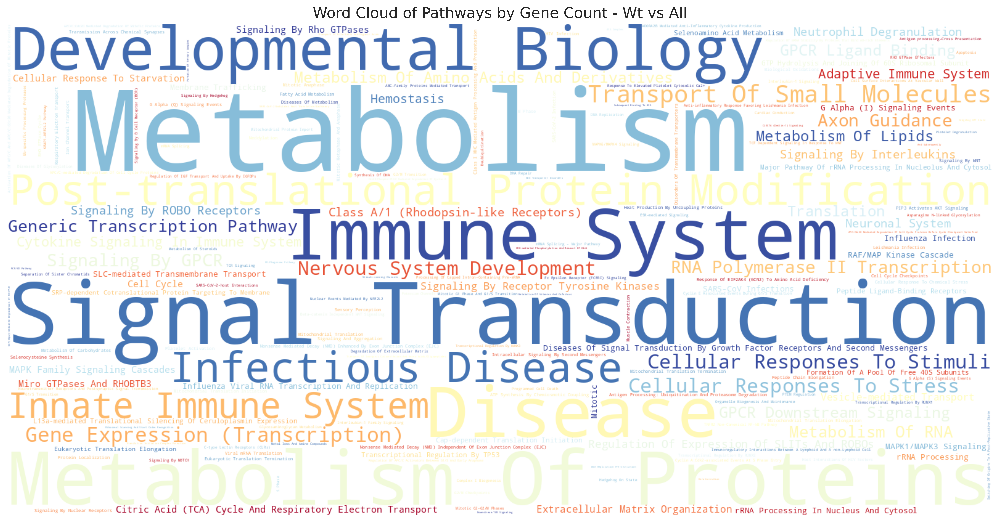

In [33]:
pathway_counts_dict = dict(zip(pathway_counts_df['Pathway'], pathway_counts_df['Gene Count']))
pathway_counts_cleaned_dict = {pathway.split(' R-HSA-')[0]: count for pathway, count in pathway_counts_dict.items()}

sns.set(style="whitegrid")
wordcloud = WordCloud(
    width=1600,  
    height=800,  
    background_color='white', 
    colormap='RdYlBu', 
    contour_color='black', 
    contour_width=1
).generate_from_frequencies(pathway_counts_cleaned_dict)

plt.figure(figsize=(16, 8), dpi=300)  
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  
plt.title("Word Cloud of Pathways by Gene Count - Wt vs All", fontsize=16)
plt.tight_layout()
plt.savefig("../differential_gene_expression/DE_results/pathway_wordcloud_logfc_1.0-Wt vs all.png")
plt.show()

In [34]:
apoptosis_related1 = pathway_counts_df[pathway_counts_df['Pathway'].str.contains("apoptosis", case=False)]

apoptosis_related1

,Pathway,Gene Count,Genes
518,Apoptosis R-HSA-109581,43,"[APAF1, APIP, C1QBP, CASP3, CLSPN, CYCS, DIABL..."
528,Regulation Of Apoptosis R-HSA-169911,27,"[PSMA1, PSMA2, PSMA4, PSMA5, PSMA6, PSMA7, PSM..."
649,Intrinsic Pathway For Apoptosis R-HSA-109606,10,"[APAF1, APIP, C1QBP, CASP3, CYCS, DIABLO, DYNL..."
1024,Defective Intrinsic Pathway For Apoptosis R-HS...,7,"[C1QBP, CAPNS1, CAPNS2, CDC25C, ERC2, PRDX1, P..."
414,TP53 Regulates Transcription Of Additional Cel...,4,"[BCL2L14, BIRC5, MPZ, NDRG1]"
1503,Apoptosis Induced DNA Fragmentation R-HSA-140342,1,[CASP3]


## Plotting Pathways

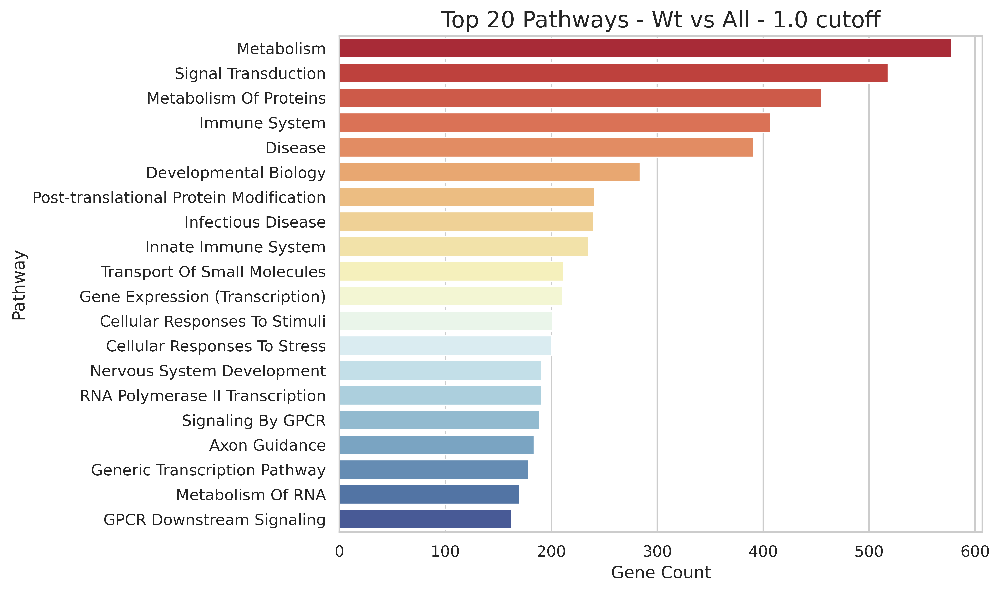

In [35]:
pathway_counts_sorted = pathway_counts_df.sort_values(by='Gene Count', ascending=False).copy()
pathway_counts_sorted['Cleaned Pathway'] = pathway_counts_sorted['Pathway'].str.split(' R-HSA-').str[0]

top_n = 20
plt.figure(figsize=(10, 6))
sns.barplot(x='Gene Count', y='Cleaned Pathway', data=pathway_counts_sorted.head(top_n), palette='RdYlBu')
plt.title(f"Top {top_n} Pathways - Wt vs All - 1.0 cutoff", fontsize=16)
plt.xlabel('Gene Count', fontsize=12)
plt.ylabel('Pathway', fontsize=12)
plt.tight_layout()
plt.show()

## Mdx_vs_all

In [36]:
filtered = stat_res2.results_df[stat_res2.results_df['log2FoldChange'].abs() > 1.0]
filtered

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
Xkr4,22.351047,1.589581,1.167985,1.360960,0.173526,0.382863
Gm19938,3.760212,2.335601,1.956368,1.193846,0.232538,NaN
Rp1,162.752680,-1.397657,0.602754,-2.318786,0.020407,0.096839
Sox17,50.682636,2.701081,0.976241,2.766818,0.005661,0.034731
Gm37587,1.209656,1.598740,3.286282,0.486489,0.626621,NaN
...,...,...,...,...,...,...
Gm21860,6.174756,3.474764,2.937541,1.182882,0.236856,0.457941
Csprs,11.336849,4.834680,1.817964,2.659393,0.007828,0.045063
Spry3,0.205268,1.861560,5.349550,0.347984,0.727852,NaN
Tmlhe,553.471669,-1.000412,0.592322,-1.688967,0.091226,0.266737


In [37]:
filtered.index = filtered.index.str.upper()
filtered.index

Index(['XKR4', 'GM19938', 'RP1', 'SOX17', 'GM37587', 'GM37323', 'RGS20',
       'GM16041', 'OPRK1', 'ST18',
       ...
       'GM20814', 'GM29564', 'GM28897', 'GM20911', 'GM21294', 'GM21860',
       'CSPRS', 'SPRY3', 'TMLHE', 'GM10931'],
      dtype='object', length=11620)

In [38]:
genes = filtered.index.tolist()  
genes

['XKR4',
 'GM19938',
 'RP1',
 'SOX17',
 'GM37587',
 'GM37323',
 'RGS20',
 'GM16041',
 'OPRK1',
 'ST18',
 'SNTG1',
 'VXN',
 'MYBL1',
 'MCMDC2',
 'TCF24',
 'PPP1R42',
 'GM15818',
 'GM17644',
 'SULF1',
 'GM29283',
 'NCOA2',
 'GM29570',
 'TRAM1',
 'GM9947',
 'MSC',
 'TRPA1',
 'SBSPON',
 'RPL7',
 'GM28095',
 'GM7568',
 'GM28376',
 'GDAP1',
 'GM28784',
 'PI15',
 'GM28154',
 'GM16070',
 'CRISPLD1',
 'GM28153',
 'CRISP4',
 'GM15825',
 'TFAP2D',
 'TFAP2B',
 'GM28653',
 'IL17F',
 'MCM3',
 'TMEM14A',
 'GSTA3',
 'GM28836',
 'KHDC1A',
 'KHDC1C',
 'KHDC1B',
 'RIMS1',
 'B3GAT2',
 'GM5524',
 'PTP4A1',
 'GM28644',
 'GM29128',
 'LGSN',
 'GM37724',
 'BEND6',
 'GM26788',
 'CCDC115',
 'PTPN18',
 'GM28417',
 'GM38336',
 'GM37068',
 'GM28415',
 'GM33280',
 'NEURL3',
 'ARID5A',
 'FER1L5',
 'SEMA4C',
 'FAM178B',
 'COX5B',
 'GM33533',
 'VWA3B',
 'INPP4A',
 'GM26805',
 'MRPL30',
 'LYG2',
 'GM5099',
 'AFF3',
 'GM16150',
 'GM16151',
 'GM16152',
 'CHST10',
 'NMS',
 'PDCL3',
 'GM37821',
 'NPAS2',
 'RPL31',
 'CREG2',

In [39]:
batch_size = 1000
gene_batches = [genes[i:i + batch_size] for i in range(0, len(genes), batch_size)]

1. Provide all necessary url and 
2. Get the list of databases available to access

In [40]:
pathway_results = submit_enrichment_batches(gene_batches)
pathway_results

Batch 1 submitted successfully. User list ID: 85977421
Batch 2 submitted successfully. User list ID: 85977425
Batch 3 submitted successfully. User list ID: 85977430
Error submitting batch 4 (Status code: 429)
Batch 4 submitted successfully. User list ID: 85977435
Batch 5 submitted successfully. User list ID: 85977439


In [41]:
pathway_results = {gene: ', '.join(pathways) for gene, pathways in pathway_results.items()}
pathways_df = pd.DataFrame.from_dict(pathway_results, orient='index', columns=['Pathways']).reset_index()
pathways_df.columns = ['Gene', 'Pathways']

filtered_with_pathways = filtered.merge(pathways_df, how='left', left_index=True, right_on='Gene')

filtered_with_pathways['Pathways'] = filtered_with_pathways['Pathways'].apply(lambda x: x.split(', ') if pd.notna(x) else [])
print(filtered_with_pathways[['Gene', 'Pathways']])

           Gene                                           Pathways
NaN        XKR4                                                 []
NaN     GM19938                                                 []
NaN         RP1                                                 []
342.0     SOX17  [Deactivation Of Beta-Catenin Transactivating ...
NaN     GM37587                                                 []
...         ...                                                ...
NaN     GM21860                                                 []
NaN       CSPRS                                                 []
NaN       SPRY3                                                 []
3848.0    TMLHE  [Metabolism Of Amino Acids And Derivatives R-H...
NaN     GM10931                                                 []

[11620 rows x 2 columns]


In [42]:
all_pathways = filtered_with_pathways['Pathways'].explode().dropna().unique().tolist()
all_pathways

['Deactivation Of Beta-Catenin Transactivating Complex R-HSA-3769402',
 'Signal Transduction R-HSA-162582',
 'Signaling By WNT R-HSA-195721',
 'TCF Dependent Signaling In Response To WNT R-HSA-201681',
 'G Alpha (I) Signaling Events R-HSA-418594',
 'G Alpha (Z) Signaling Events R-HSA-418597',
 'Signaling By GPCR R-HSA-372790',
 'GPCR Downstream Signaling R-HSA-388396',
 'Peptide Ligand-Binding Receptors R-HSA-375276',
 'MECP2 Regulates Neuronal Receptors And Channels R-HSA-9022699',
 'Transcriptional Regulation By MECP2 R-HSA-8986944',
 'Class A/1 (Rhodopsin-like Receptors) R-HSA-373076',
 'GPCR Ligand Binding R-HSA-500792',
 'Generic Transcription Pathway R-HSA-212436',
 'RNA Polymerase II Transcription R-HSA-73857',
 'Gene Expression (Transcription) R-HSA-74160',
 'PIWI-interacting RNA (piRNA) Biogenesis R-HSA-5601884',
 'Gene Silencing By RNA R-HSA-211000',
 'Cytoprotection By HMOX1 R-HSA-9707564',
 'PPARA Activates Gene Expression R-HSA-1989781',
 'Regulation Of Lipid Metabolism By

Obtain the count of genes for each Pathway along with their Gene list

In [43]:
pathway_gene_counts = {}

for index, row in filtered_with_pathways.iterrows():
    gene_name = row['Gene']  
    pathways = row['Pathways']  
    

    for pathway in pathways:

        if pathway in pathway_gene_counts:
            pathway_gene_counts[pathway]['Gene Count'] += 1
            pathway_gene_counts[pathway]['Genes'].add(gene_name)  
        else:

            pathway_gene_counts[pathway] = {'Gene Count': 1, 'Genes': {gene_name}}


pathway_counts_df = pd.DataFrame([
    {'Pathway': pathway, 'Gene Count': data['Gene Count'], 'Genes': sorted(data['Genes'])}
    for pathway, data in pathway_gene_counts.items()
])


pathway_counts_df = pathway_counts_df.sort_values(by='Gene Count', ascending=False)
pathway_counts_df

,Pathway,Gene Count,Genes
1,Signal Transduction R-HSA-162582,1085,"[AAMP, ABCD3, ABCG1, ABCG5, ABHD17A, ABR, ACKR..."
55,Metabolism R-HSA-1430728,858,"[AADAC, AANAT, AASS, ABCC2, ABCC3, ABCC5, ABO,..."
113,Immune System R-HSA-168256,851,"[A1BG, AAMP, ABCA13, ACLY, ACTR2, ADAM8, ADGRE..."
60,Metabolism Of Proteins R-HSA-392499,736,"[ACE, ACE2, ACHE, ADAMTS1, ADAMTS10, ADAMTS12,..."
75,Disease R-HSA-1643685,733,"[ABCB6, ABCC2, ABCG5, ACAN, ACE2, ACTR2, ADAMT..."
...,...,...,...
1687,SUMOylation Of SUMOylation Proteins R-HSA-4085377,1,[NUP62]
419,N-glycan Trimming And Elongation In cis-Golgi ...,1,[MOGAT1]
942,Transport Of RCbl Within Body R-HSA-9758890,1,[LRP2]
1663,Wax And Plasmalogen Biosynthesis R-HSA-8848584,1,[FAR2]


In [44]:
pathway_counts_df.to_csv(f'../differential_gene_expression/DE_results/dmd_de_pathways_Mdx_all_logfc_1.0_{timestamp}.csv')

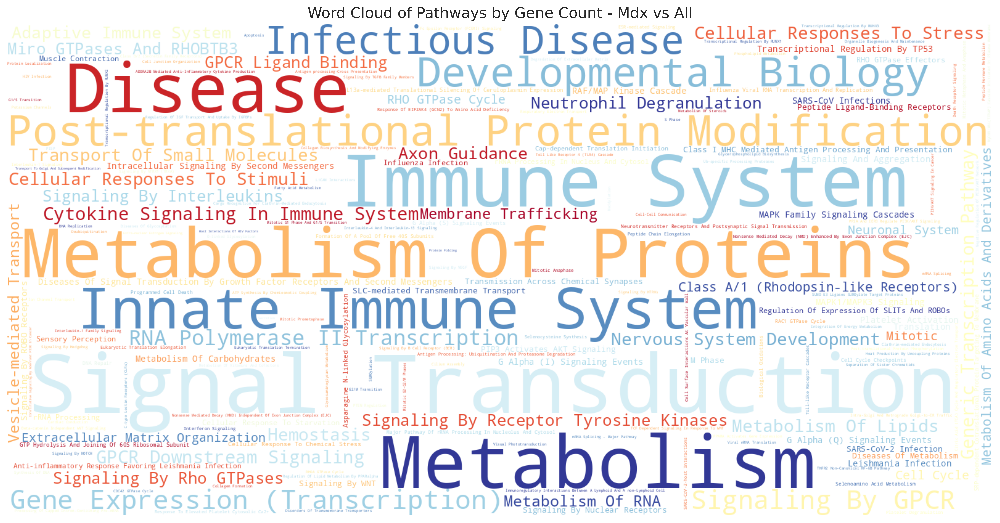

In [45]:
pathway_counts_dict = dict(zip(pathway_counts_df['Pathway'], pathway_counts_df['Gene Count']))
pathway_counts_cleaned_dict = {pathway.split(' R-HSA-')[0]: count for pathway, count in pathway_counts_dict.items()}

sns.set(style="whitegrid")
wordcloud = WordCloud(
    width=1600,  
    height=800,  
    background_color='white', 
    colormap='RdYlBu', 
    contour_color='black', 
    contour_width=1
).generate_from_frequencies(pathway_counts_cleaned_dict)

plt.figure(figsize=(16, 8), dpi=300)  
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  
plt.title("Word Cloud of Pathways by Gene Count - Mdx vs All", fontsize=16)
plt.tight_layout()
plt.savefig("../differential_gene_expression/DE_results/pathway_wordcloud_logfc_1.0- Mdx vs all.png")
plt.show()

In [46]:
apoptosis_related2 = pathway_counts_df[pathway_counts_df['Pathway'].str.contains("apoptosis", case=False)]

apoptosis_related2

,Pathway,Gene Count,Genes
297,Apoptosis R-HSA-109581,74,"[AKT3, APAF1, ARHGAP10, AVEN, BAX, BBC3, BCAP3..."
288,Intrinsic Pathway For Apoptosis R-HSA-109606,26,"[AKT3, APAF1, AVEN, BAX, BBC3, BCL2L1, BID, BM..."
990,Regulation Of Apoptosis R-HSA-169911,22,"[ARHGAP10, PSMA4, PSMA6, PSMA7, PSMB10, PSMB3,..."
761,Defective Intrinsic Pathway For Apoptosis R-HS...,13,"[APP, C1QBP, CAPN1, CAPN2, CAPNS1, CAPNS2, CDC..."
1659,TP53 Regulates Transcription Of Additional Cel...,6,"[BCL2L14, BCL6, BIRC5, NDRG1, PERP, RABGGTA]"
1506,Apoptosis Induced DNA Fragmentation R-HSA-140342,5,"[CASP3, DFFB, HMGB1, HMGB2, KPNB1]"
1720,Suppression Of Apoptosis R-HSA-9635465,4,"[CTSG, MAPK3, RNF213, TRIM27]"


## Plotting Pathways

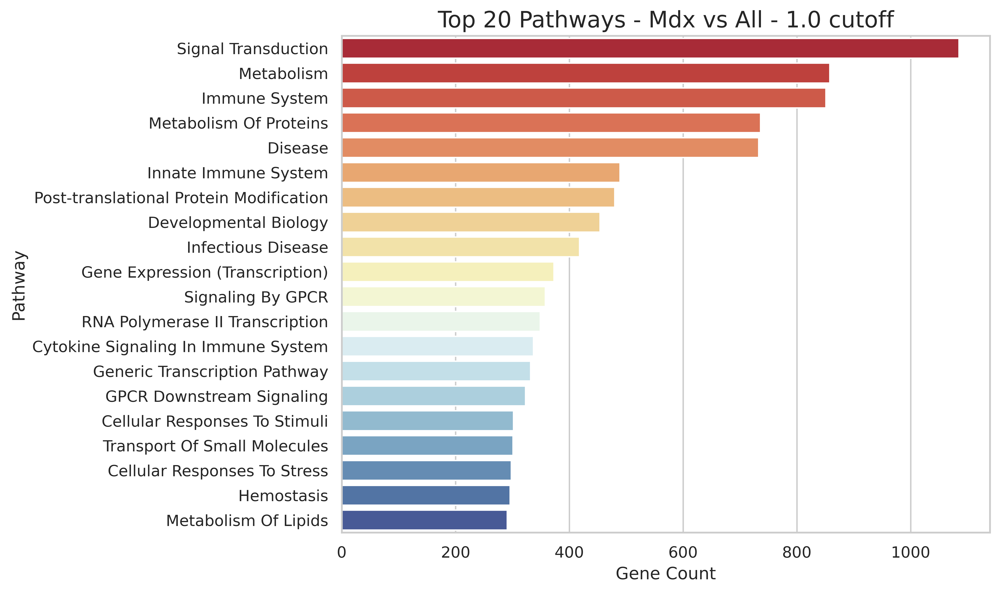

In [47]:
pathway_counts_sorted = pathway_counts_df.sort_values(by='Gene Count', ascending=False).copy()
pathway_counts_sorted['Cleaned Pathway'] = pathway_counts_sorted['Pathway'].str.split(' R-HSA-').str[0]

top_n = 20
plt.figure(figsize=(10, 6))
sns.barplot(x='Gene Count', y='Cleaned Pathway', data=pathway_counts_sorted.head(top_n), palette='RdYlBu')
plt.title(f"Top {top_n} Pathways - Mdx vs All - 1.0 cutoff", fontsize=16)
plt.xlabel('Gene Count', fontsize=12)
plt.ylabel('Pathway', fontsize=12)
plt.tight_layout()
plt.show()

## MdxSCID_vs_all

In [48]:
filtered = stat_res3.results_df[stat_res3.results_df['log2FoldChange'].abs() > 1.0]
filtered

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
Gm1992,2.148276,1.191606,2.750488,0.433234,0.664844,NaN
Gm19938,3.760212,-2.278383,1.967253,-1.158154,0.246801,NaN
Gm37381,10.087941,-1.719087,1.199375,-1.433318,0.151767,NaN
Gm37323,0.069963,-1.356078,5.486381,-0.247172,0.804775,NaN
Mrpl15,731.976396,1.292232,0.623634,2.072100,0.038256,0.462475
...,...,...,...,...,...,...
Gm28827,0.065341,1.082546,5.486113,0.197325,0.843573,NaN
Gm20837,0.065341,1.082546,5.486113,0.197325,0.843573,NaN
Gm21860,6.174756,3.100848,1.747476,1.774472,0.075985,NaN
Gm47283,804.296795,1.312454,0.574118,2.286034,0.022252,0.358795


In [49]:
filtered.index = filtered.index.str.upper()
filtered.index

Index(['GM1992', 'GM19938', 'GM37381', 'GM37323', 'MRPL15', 'RGS20', 'GM16041',
       'OPRK1', 'ALKAL1', 'ST18',
       ...
       'GM28612', 'GM20843', 'GM29564', 'GM28897', 'GM21317', 'GM28827',
       'GM20837', 'GM21860', 'GM47283', 'GM10931'],
      dtype='object', length=8515)

In [50]:
genes = filtered.index.tolist()  
genes

['GM1992',
 'GM19938',
 'GM37381',
 'GM37323',
 'MRPL15',
 'RGS20',
 'GM16041',
 'OPRK1',
 'ALKAL1',
 'ST18',
 'VXN',
 'SNHG6',
 'GM15818',
 'GM29283',
 'SBSPON',
 'RPL7',
 'GM7568',
 'ELOC',
 'TMEM70',
 'GM28376',
 'GM28783',
 'GDAP1',
 'GM28784',
 'PI15',
 'GM28153',
 'GM28756',
 'GM15825',
 'TFAP2D',
 'TFAP2B',
 'GM28653',
 'IL17F',
 'PAQR8',
 'TMEM14A',
 'KHDC1A',
 'KHDC1C',
 'KHDC1B',
 'KCNQ5',
 'GM27028',
 'B3GAT2',
 'SDHAF4',
 'COL19A1',
 'GM5524',
 'GM597',
 'PTP4A1-1',
 'GM28644',
 'LGSN',
 'GM37724',
 'BEND6',
 'GM26788',
 'GM37958',
 'GM28417',
 'PRSS40',
 'GM37068',
 'GM28415',
 'GM33222',
 'GM37335',
 'GM33280',
 'FER1L5',
 'ANKRD23',
 'COX5B',
 'GM33533',
 'ZAP70',
 'VWA3B',
 'GM37020',
 'UNC50',
 'GM26805',
 'LIPT1',
 'MRPL30',
 'GM15457',
 'GM16151',
 'GM37707',
 'GM37821',
 'RPL31',
 'RNF149',
 'RFX8',
 'GM3646',
 'IL1R2',
 'IL1RL2',
 'IL1RL1',
 'IL18R1',
 'IL18RAP',
 'GM35801',
 'GM37623',
 'GM29260',
 'GM28175',
 'GM28140',
 'GM20646',
 'POU3F3',
 'GPR45',
 'GM29155'

In [51]:
batch_size = 1000
gene_batches = [genes[i:i + batch_size] for i in range(0, len(genes), batch_size)]


1. Provide all necessary url and 
2. Get the list of databases available to access

In [52]:
pathway_results = submit_enrichment_batches(gene_batches)
pathway_results

Batch 1 submitted successfully. User list ID: 85977054
Batch 2 submitted successfully. User list ID: 85977057
Batch 3 submitted successfully. User list ID: 85977060
Batch 4 submitted successfully. User list ID: 85977062
Batch 5 submitted successfully. User list ID: 85977064
Batch 6 submitted successfully. User list ID: 85977067
Batch 7 submitted successfully. User list ID: 85977070
Batch 8 submitted successfully. User list ID: 85977072


Batch 9 submitted successfully. User list ID: 85977074


{'SPTBN5': ['Interaction Between L1 And Ankyrins R-HSA-445095',
  'NCAM Signaling For Neurite Out-Growth R-HSA-375165',
  'L1CAM Interactions R-HSA-373760',
  'Axon Guidance R-HSA-422475',
  'Nervous System Development R-HSA-9675108',
  'ER To Golgi Anterograde Transport R-HSA-199977',
  'Transport To Golgi And Subsequent Modification R-HSA-948021',
  'COPI-mediated Anterograde Transport R-HSA-6807878',
  'RAF/MAP Kinase Cascade R-HSA-5673001',
  'MAPK1/MAPK3 Signaling R-HSA-5684996',
  'MAPK Family Signaling Cascades R-HSA-5683057',
  'Asparagine N-linked Glycosylation R-HSA-446203',
  'Developmental Biology R-HSA-1266738',
  'Vesicle-mediated Transport R-HSA-5653656',
  'Metabolism Of Proteins R-HSA-392499',
  'Membrane Trafficking R-HSA-199991',
  'Signal Transduction R-HSA-162582',
  'Post-translational Protein Modification R-HSA-597592'],
 'NFASC': ['Interaction Between L1 And Ankyrins R-HSA-445095',
  'L1CAM Interactions R-HSA-373760',
  'Neurofascin Interactions R-HSA-447043',
 

In [53]:
pathway_results = {gene: ', '.join(pathways) for gene, pathways in pathway_results.items()}
pathways_df = pd.DataFrame.from_dict(pathway_results, orient='index', columns=['Pathways']).reset_index()
pathways_df.columns = ['Gene', 'Pathways']

filtered_with_pathways = filtered.merge(pathways_df, how='left', left_index=True, right_on='Gene')

filtered_with_pathways['Pathways'] = filtered_with_pathways['Pathways'].apply(lambda x: x.split(', ') if pd.notna(x) else [])
print(filtered_with_pathways[['Gene', 'Pathways']])

         Gene                                           Pathways
NaN    GM1992                                                 []
NaN   GM19938                                                 []
NaN   GM37381                                                 []
NaN   GM37323                                                 []
63.0   MRPL15  [Mitochondrial Translation Elongation R-HSA-53...
...       ...                                                ...
NaN   GM28827                                                 []
NaN   GM20837                                                 []
NaN   GM21860                                                 []
NaN   GM47283                                                 []
NaN   GM10931                                                 []

[8515 rows x 2 columns]


In [54]:
all_pathways = filtered_with_pathways['Pathways'].explode().dropna().unique().tolist()
all_pathways

['Mitochondrial Translation Elongation R-HSA-5389840',
 'Mitochondrial Translation Initiation R-HSA-5368286',
 'Mitochondrial Translation Termination R-HSA-5419276',
 'Mitochondrial Translation R-HSA-5368287',
 'Translation R-HSA-72766',
 'Metabolism Of Proteins R-HSA-392499',
 'G Alpha (Z) Signaling Events R-HSA-418597',
 'G Alpha (I) Signaling Events R-HSA-418594',
 'Signaling By GPCR R-HSA-372790',
 'GPCR Downstream Signaling R-HSA-388396',
 'Signal Transduction R-HSA-162582',
 'MECP2 Regulates Neuronal Receptors And Channels R-HSA-9022699',
 'Peptide Ligand-Binding Receptors R-HSA-375276',
 'Class A/1 (Rhodopsin-like Receptors) R-HSA-373076',
 'GPCR Ligand Binding R-HSA-500792',
 'Transcriptional Regulation By MECP2 R-HSA-8986944',
 'Gene Expression (Transcription) R-HSA-74160',
 'RNA Polymerase II Transcription R-HSA-73857',
 'Generic Transcription Pathway R-HSA-212436',
 'Defective B3GALTL Causes PpS R-HSA-5083635',
 'O-glycosylation Of TSR Domain-Containing Proteins R-HSA-517321

Obtain the count of genes for each Pathway along with their Gene list

In [55]:
pathway_gene_counts = {}

for index, row in filtered_with_pathways.iterrows():
    gene_name = row['Gene']  
    pathways = row['Pathways']  
    

    for pathway in pathways:

        if pathway in pathway_gene_counts:
            pathway_gene_counts[pathway]['Gene Count'] += 1
            pathway_gene_counts[pathway]['Genes'].add(gene_name)  
        else:

            pathway_gene_counts[pathway] = {'Gene Count': 1, 'Genes': {gene_name}}


pathway_counts_df = pd.DataFrame([
    {'Pathway': pathway, 'Gene Count': data['Gene Count'], 'Genes': sorted(data['Genes'])}
    for pathway, data in pathway_gene_counts.items()
])


pathway_counts_df = pathway_counts_df.sort_values(by='Gene Count', ascending=False)
pathway_counts_df

,Pathway,Gene Count,Genes
54,Metabolism R-HSA-1430728,578,"[AADAC, AANAT, AASS, ABO, ACAA2, ACADL, ACADM,..."
10,Signal Transduction R-HSA-162582,517,"[ABCG1, ABCG5, ABCG8, ACKR4, ACTC1, ACVR1C, AD..."
5,Metabolism Of Proteins R-HSA-392499,455,"[ACE, ADAMTS13, ADAMTS15, ADAMTS18, ADAMTS20, ..."
81,Immune System R-HSA-168256,406,"[A1BG, ABCA13, ADAM8, ADGRG3, AIM2, ALAD, ALOX..."
25,Disease R-HSA-1643685,391,"[ABCG5, ABCG8, ACAN, ADAMTS13, ADAMTS15, ADAMT..."
...,...,...,...
1675,Lectin Pathway Of Complement Activation R-HSA-...,1,[COLEC10]
1676,Creation Of C4 And C2 Activators R-HSA-166786,1,[COLEC10]
1678,HuR (ELAVL1) Binds And Stabilizes mRNA R-HSA-4...,1,[ENPP2]
1679,Transcription Of E2F Targets Under Negative Co...,1,[MYC]


In [56]:
pathway_counts_df.to_csv(f'../differential_gene_expression/DE_results/dmd_de_pathways_Mdxscid_all_logfc_1.0_{timestamp}.csv')

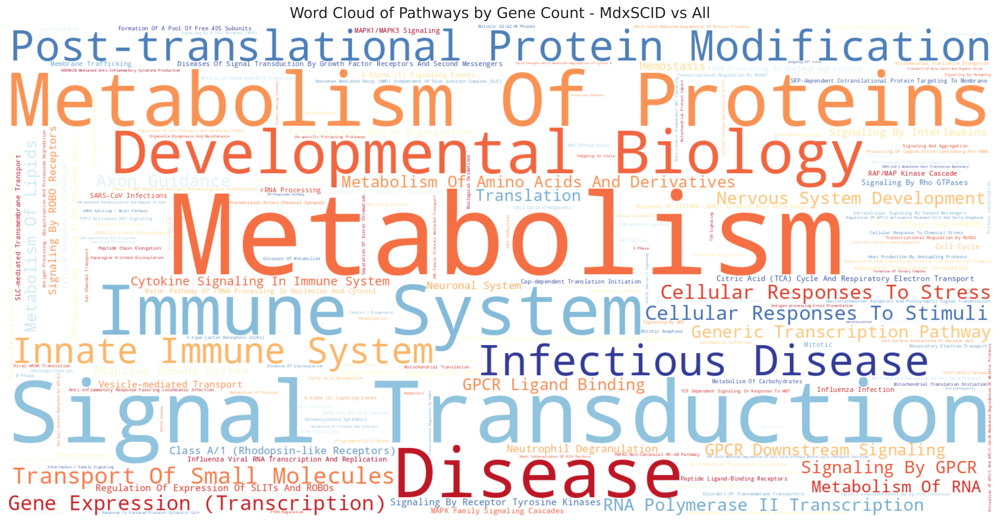

In [57]:
pathway_counts_dict = dict(zip(pathway_counts_df['Pathway'], pathway_counts_df['Gene Count']))
pathway_counts_cleaned_dict = {pathway.split(' R-HSA-')[0]: count for pathway, count in pathway_counts_dict.items()}

sns.set(style="whitegrid")
wordcloud = WordCloud(
    width=1600,  
    height=800,  
    background_color='white', 
    colormap='RdYlBu', 
    contour_color='black', 
    contour_width=1
).generate_from_frequencies(pathway_counts_cleaned_dict)

plt.figure(figsize=(16, 8), dpi=300)  
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  
plt.title("Word Cloud of Pathways by Gene Count - MdxSCID vs All", fontsize=16)
plt.tight_layout()
plt.savefig("../differential_gene_expression/DE_results/pathway_wordcloud_logfc_1.0-MdxSCID vs all.png")
plt.show()

In [58]:
apoptosis_related3 = pathway_counts_df[pathway_counts_df['Pathway'].str.contains("apoptosis", case=False)]

apoptosis_related3

,Pathway,Gene Count,Genes
518,Apoptosis R-HSA-109581,43,"[APAF1, APIP, C1QBP, CASP3, CLSPN, CYCS, DIABL..."
528,Regulation Of Apoptosis R-HSA-169911,27,"[PSMA1, PSMA2, PSMA4, PSMA5, PSMA6, PSMA7, PSM..."
649,Intrinsic Pathway For Apoptosis R-HSA-109606,10,"[APAF1, APIP, C1QBP, CASP3, CYCS, DIABLO, DYNL..."
1024,Defective Intrinsic Pathway For Apoptosis R-HS...,7,"[C1QBP, CAPNS1, CAPNS2, CDC25C, ERC2, PRDX1, P..."
414,TP53 Regulates Transcription Of Additional Cel...,4,"[BCL2L14, BIRC5, MPZ, NDRG1]"
1503,Apoptosis Induced DNA Fragmentation R-HSA-140342,1,[CASP3]


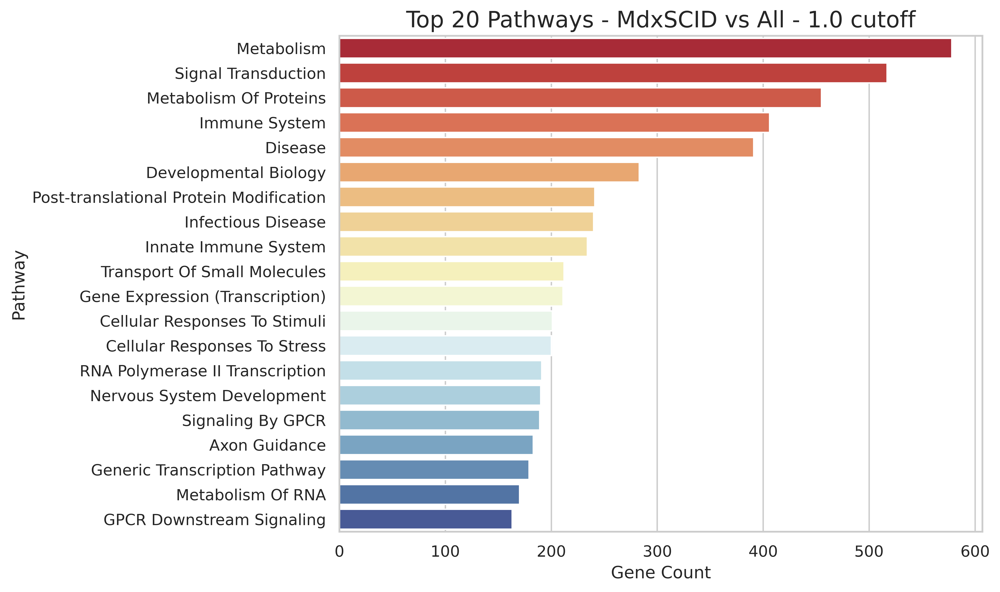

In [59]:
pathway_counts_sorted = pathway_counts_df.sort_values(by='Gene Count', ascending=False).copy()
pathway_counts_sorted['Cleaned Pathway'] = pathway_counts_sorted['Pathway'].str.split(' R-HSA-').str[0]

top_n = 20
plt.figure(figsize=(10, 6))
sns.barplot(x='Gene Count', y='Cleaned Pathway', data=pathway_counts_sorted.head(top_n), palette='RdYlBu')
plt.title(f"Top {top_n} Pathways - MdxSCID vs All - 1.0 cutoff", fontsize=16)
plt.xlabel('Gene Count', fontsize=12)
plt.ylabel('Pathway', fontsize=12)
plt.tight_layout()
plt.show()

## Plotting all apoptotic genes

In [60]:
apoptosis_genes1 = [gene for genes in apoptosis_related1['Genes'] for gene in genes]
apoptosis_genes2 = [gene for genes in apoptosis_related2['Genes'] for gene in genes]
apoptosis_genes3 = [gene for genes in apoptosis_related3['Genes'] for gene in genes]

In [61]:
X_is_raw(adata)

True

In [62]:
all_apoptosis_genes = list(set([gene.capitalize() for genes in [apoptosis_genes1, apoptosis_genes2, apoptosis_genes3] for gene in genes]))
filtered_genes = [gene for gene in all_apoptosis_genes if gene in adata.var_names]

if not filtered_genes:
    raise ValueError("None of the apoptosis-related genes are found in the dataset.")
else:
    print(f"Filtered genes found in dataset: {filtered_genes}")

gene_indices = [adata.var_names.get_loc(gene) for gene in filtered_genes]

sc.pp.normalize_total(adata, target_sum= 1e6)
sc.pp.log1p(adata)

expression_data = adata.X

if issparse(expression_data):
    expression_data = expression_data.toarray()

apoptosis_expr = expression_data[:, gene_indices]

apoptosis_expr_df = pd.DataFrame(apoptosis_expr, columns=filtered_genes, index=adata.obs_names)
apoptosis_expr_df['genotype'] = adata.obs['genotype'].values  
apoptosis_expr_by_sample = apoptosis_expr_df.groupby('genotype').mean()

if apoptosis_expr_by_sample.isnull().all().all():
    raise ValueError("The aggregated DataFrame still contains all NaN values. Check sample and gene indexing.")
else:
    print("Aggregated apoptosis gene expression by sample:", apoptosis_expr_by_sample)


plt.figure(figsize=(12, len(filtered_genes) * 0.3))
sns.heatmap(apoptosis_expr_by_sample.T, cmap='RdYlBu_r', annot=True, cbar=True)
plt.title("Apoptosis-Related Gene Expression Across Genotypes")
plt.xlabel("Samples")
plt.ylabel("Apoptosis-Related Genes - 1.0 cutoff")
plt.grid(False)
plt.savefig(f'../differential_gene_expression/figures/plots/apoptotic_de_genes_logfc_1.0.png', format='png', dpi=300, bbox_inches='tight')
plt.show()

Filtered genes found in dataset: ['Prkcd', 'Cdc25b', 'Mapk3', 'Psma2', 'Birc5', 'Bcl2l14', 'Ubc', 'Maged1', 'Foxo3', 'Psmc4', 'Psmb1', 'Psma1', 'Psmc3', 'Psmd10', 'Ripk1', 'Capn2', 'Vim', 'Trim27', 'Bcl2l1', 'Psma5', 'Psma4', 'Proc', 'Cycs', 'Psmd8', 'Unc5b', 'Pmaip1', 'Dsg3', 'Tlr4', 'Ubb', 'Dynll1', 'Stat3', 'Bcl6', 'Gsdme', 'Dffb', 'Psmb4', 'Rps27a', 'Ctsg', 'Capns1', 'Pkp1', 'Aven', 'Psmb10', 'Psmb7', 'Ocln', 'Ywhab', 'Gsn', 'Clspn', 'Rexo2', 'Mpz', 'Bid', 'Fadd', 'Sem1', 'Psmd2', 'E2f1', 'Ywhah', 'Psmc5', 'Uba52', 'Kpnb1', 'Casp3', 'Ndrg1', 'Dynll2', 'Apaf1', 'Psme2', 'Jun', 'Dapk2', 'Psmb9', 'Apip', 'Bcap31', 'Hmgb2', 'Akt3', 'Arhgap10', 'Psmb5', 'Stk26', 'Capn1', 'Psmb3', 'Gsdmd', 'Gzmb', 'Psma7', 'Psmd6', 'Bax', 'Fasn', 'Rabggta', 'Ppp3cc', 'Ndufa2', 'Tnfsf10', 'Psma6', 'C1qbp', 'Tfdp2', 'Cdkn2a', 'Psmb6', 'Unc5a', 'Perp', 'Tradd', 'App', 'Hmgb1', 'Prdx1', 'Bmx', 'Psmb8', 'Psme3', 'Diablo', 'Psme1', 'Bmf', 'Cdc25c', 'Rnf213', 'Erc2', 'Bbc3', 'Casp8', 'Psmc2', 'Prdx2', 'Psmd12',

In [63]:
pathway_1_genes = apoptosis_related1['Genes'].explode().str.capitalize().tolist()  # Convert gene names to capitalizeid
pathway_2_genes = apoptosis_related2['Genes'].explode().str.capitalize().tolist()  
pathway_3_genes = apoptosis_related3['Genes'].explode().str.capitalize().tolist()  

In [64]:
apoptosis_related1

,Pathway,Gene Count,Genes
518,Apoptosis R-HSA-109581,43,"[APAF1, APIP, C1QBP, CASP3, CLSPN, CYCS, DIABL..."
528,Regulation Of Apoptosis R-HSA-169911,27,"[PSMA1, PSMA2, PSMA4, PSMA5, PSMA6, PSMA7, PSM..."
649,Intrinsic Pathway For Apoptosis R-HSA-109606,10,"[APAF1, APIP, C1QBP, CASP3, CYCS, DIABLO, DYNL..."
1024,Defective Intrinsic Pathway For Apoptosis R-HS...,7,"[C1QBP, CAPNS1, CAPNS2, CDC25C, ERC2, PRDX1, P..."
414,TP53 Regulates Transcription Of Additional Cel...,4,"[BCL2L14, BIRC5, MPZ, NDRG1]"
1503,Apoptosis Induced DNA Fragmentation R-HSA-140342,1,[CASP3]


In [65]:
pathway_1_results = stat_res1.results_df[stat_res1.results_df.index.isin(pathway_1_genes)]
pathway_2_results = stat_res2.results_df[stat_res2.results_df.index.isin(pathway_2_genes)]
pathway_3_results = stat_res3.results_df[stat_res3.results_df.index.isin(pathway_3_genes)]

# Extract log fold changes and p-values for each pathway
logfc_pvalues_pathway_1 = pathway_1_results[['log2FoldChange', 'pvalue']]
logfc_pvalues_pathway_2 = pathway_2_results[['log2FoldChange', 'pvalue']]
logfc_pvalues_pathway_3 = pathway_3_results[['log2FoldChange', 'pvalue']]

# Combine the results into a single DataFrame for all pathways
combined_results = pd.concat([
    logfc_pvalues_pathway_1.assign(comparision='Wt vs all'),
    logfc_pvalues_pathway_2.assign(comparision="Mdx vs all"),
    logfc_pvalues_pathway_3.assign(comparision="MdxSCID vs all")
])
combined_results

,log2FoldChange,pvalue,comparision
Mpz,-1.029754,0.686298,Wt vs all
Gsn,1.166257,0.085318,Wt vs all
Psmb7,-1.433736,0.021303,Wt vs all
Psmc3,-1.352786,0.042382,Wt vs all
Apip,-2.011931,0.000461,Wt vs all
...,...,...,...
Dsg3,1.141524,0.579328,MdxSCID vs all
Cdc25c,1.676158,0.666118,MdxSCID vs all
Ndufa2,1.541375,0.021107,MdxSCID vs all
Stk26,-1.959408,0.132825,MdxSCID vs all


In [66]:
combined_results.to_csv(f'../differential_gene_expression/DE_results/apoptosis_genes_logfc_1.0_pvalues_combined_{timestamp}.csv')

In [67]:
heatmap_data = combined_results.pivot_table(
    index=combined_results.index,  
    columns='comparision',  
    values='log2FoldChange', fill_value=0) 

plt.figure(figsize=(12, len(filtered_genes) * 0.3))
sns.heatmap(heatmap_data,cmap='RdYlBu_r', annot=True,fmt=".2f",cbar_kws={'label': 'Log Fold Change'}  )
plt.title("Log Fold Change Heatmap Across Comparisons - 1.0 cutoff", fontsize=16)
plt.xlabel("Comparison", fontsize=12)
plt.ylabel("Pathway", fontsize=12)
plt.grid(False)
plt.tight_layout()
plt.show()